In [67]:
import numpy as np, pandas as pd

import plotly.offline as py
import plotly.graph_objs as go
%matplotlib inline 
py.init_notebook_mode()


import requests
import time, logging, os, requests

import datetime


import xgboost as xgb 

from sklearn.model_selection import RandomizedSearchCV, TimeSeriesSplit, train_test_split

from tqdm._tqdm_notebook import tqdm_notebook
tqdm_notebook.pandas()

import lightgbm as lgb

from sklearn.metrics import mean_squared_error
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM

In [2]:
!ls

1-1.ipynb	dates.csv   submission.csv  train.csv .zip   Untitled.ipynb
11_stack.ipynb	figure.pdf  train_1.csv     trainmon.csv
1-2.ipynb	hol.csv     train.csv	    Untitled1.ipynb


## Load

In [3]:
df = pd.read_csv('train.csv')

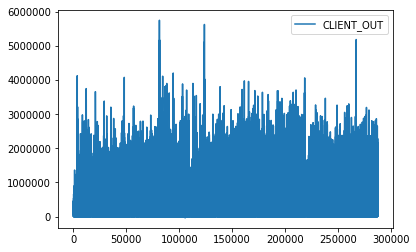

In [4]:
df[['DATE', 'CLIENT_OUT']].plot()

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7ff9e28e8940>]],
      dtype=object)

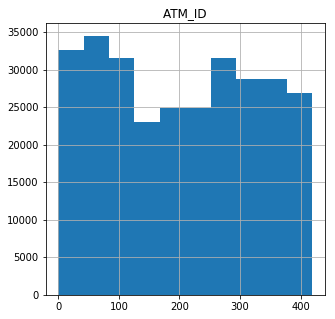

In [5]:
df[['ATM_ID']].hist(figsize = (5, 5))

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7ff9e285a160>,
      dtype=object)

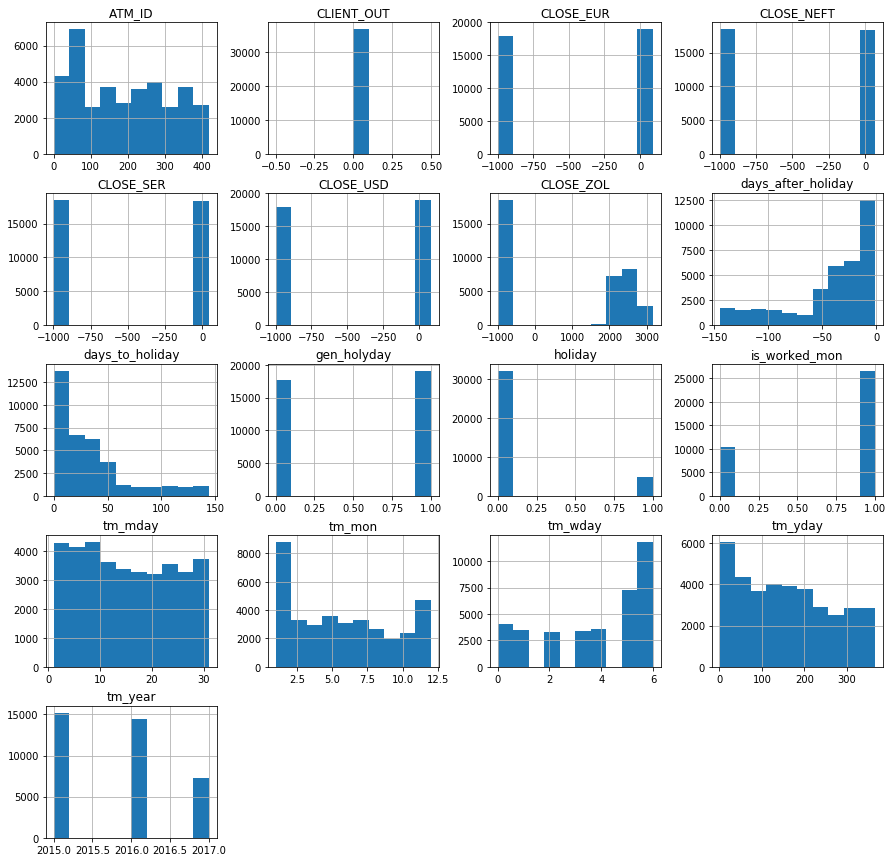

In [6]:
df[df['CLIENT_OUT']==0].hist(figsize = (15, 15))

In [7]:
df.columns

Index(['DATE', 'holiday', 'tm_year', 'tm_mon', 'tm_mday', 'tm_wday',
       'gen_holyday', 'tm_yday', 'CLOSE_USD', 'CLOSE_EUR', 'CLOSE_ZOL',
       'CLOSE_NEFT', 'CLOSE_SER', 'days_to_holiday', 'days_after_holiday',
       'ATM_ID', 'is_worked_mon', 'CLIENT_OUT'],
      dtype='object')

In [8]:
w_trace =  go.Scatter(x=df['DATE'].unique(), y=df['CLIENT_OUT'], name= 'withdraw')
py.iplot([w_trace])

In [9]:
from sklearn.preprocessing import MinMaxScaler


In [10]:
values = df['CLIENT_OUT'].values.reshape(-1,1)
values = values.astype('float32')
scaler = MinMaxScaler(feature_range=(0, 1))
scaled = scaler.fit_transform(values)

In [11]:
df['CLIENT_OUT_SCALED'] = scaled

In [12]:
w_trace =  go.Scatter(x=df['DATE'].unique(), y=df['CLIENT_OUT_SCALED'], name= 'withdraw')
py.iplot([w_trace])

In [15]:
from sklearn.metrics import make_scorer

def score_series(y_true, y_pred):
    """
        Expects y_true and y_pred to be 1d arrays of the same lenght
    """
    return np.sum(np.abs(y_true - y_pred))/np.sum(np.abs(y_true))*10000

scorer = make_scorer(score_series)

In [77]:
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
    n_vars = 1 if type(data) is list else data.shape[1]
    df = pd.DataFrame(data)
    cols, names = list(), list()
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
        cols.append(df.shift(i))
        names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df.shift(-i))
        if i == 0:
            names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
        else:
            names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
    # put it all together
    agg = pd.concat(cols, axis=1)
    agg.columns = names
    # drop rows with NaN values
    if dropnan:
        agg.dropna(inplace=True)
    return agg

In [80]:
X, y = df[[col for col in df.columns if col not in ['is_worked_mon', 'CLIENT_OUT', 'CLIENT_OUT_SCALED','DATE']]].astype(np.float32), df['CLIENT_OUT_SCALED'].values

In [ ]:
series_to_supervised()

In [75]:
multi_model = Sequential()
multi_model.add(LSTM(100, input_shape=(X_train.shape[0], X_train.shape[1])))
multi_model.add(Dense(1))
multi_model.compile(loss='mae', optimizer='adam')
multi_history = multi_model.fit(X_train, y_train, epochs=300, batch_size=100, validation_data=(X_test, y_test), verbose=0, shuffle=False)

ValueError: Error when checking input: expected lstm_1_input to have 3 dimensions, but got array with shape (192558, 15)

In [74]:
X_train.shape

(192558, 15)

In [81]:
X

,holiday,tm_year,tm_mon,tm_mday,tm_wday,gen_holyday,tm_yday,CLOSE_USD,CLOSE_EUR,CLOSE_ZOL,CLOSE_NEFT,CLOSE_SER,days_to_holiday,days_after_holiday,ATM_ID
0,1.0,2015.0,1.0,1.0,3.0,0.0,1.0,56.237598,68.368103,2168.340088,56.509998,28.549999,0.0,-1.0,0.0
1,1.0,2015.0,1.0,1.0,3.0,0.0,1.0,56.237598,68.368103,2168.340088,56.509998,28.549999,0.0,-1.0,80.0
2,1.0,2015.0,1.0,1.0,3.0,0.0,1.0,56.237598,68.368103,2168.340088,56.509998,28.549999,0.0,-1.0,374.0
3,1.0,2015.0,1.0,1.0,3.0,0.0,1.0,56.237598,68.368103,2168.340088,56.509998,28.549999,0.0,-1.0,81.0
4,1.0,2015.0,1.0,1.0,3.0,0.0,1.0,56.237598,68.368103,2168.340088,56.509998,28.549999,0.0,-1.0,82.0
5,1.0,2015.0,1.0,1.0,3.0,0.0,1.0,56.237598,68.368103,2168.340088,56.509998,28.549999,0.0,-1.0,373.0
6,1.0,2015.0,1.0,1.0,3.0,0.0,1.0,56.237598,68.368103,2168.340088,56.509998,28.549999,0.0,-1.0,84.0
7,1.0,2015.0,1.0,1.0,3.0,0.0,1.0,56.237598,68.368103,2168.340088,56.509998,28.549999,0.0,-1.0,79.0
8,1.0,2015.0,1.0,1.0,3.0,0.0,1.0,56.237598,68.368103,2168.340088,56.509998,28.549999,0.0,-1.0,85.0
9,1.0,2015.0,1.0,1.0,3.0,0.0,1.0,56.237598,68.368103,2168.340088,56.509998,28.549999,0.0,-1.0,372.0
